# Summary of The Workflow
This notebook shows the workflow the solution development to fulfil the project's task. The workflow had the following milestones:
1. The preporcessing of the COCO json label file to remove duplicates,  missing labels and to control for corrupted/missing image files.
2. The creation of a ``postive dataframe`` that states the image id ``img_id`` with the corresponding image ``name``. The ``cocoParser`` class generates the segmentation target mask ``seg`` for each image along with a ``border`` mask which was later discarded from this solution.
3. Using the postive dataframe, the ``buildSplits`` class uses ``Sklearn`` splitting function to generate the train, validation, splits, where each split is produced as a dataframe.
4. The ``augmentation`` class uses each split dataframe to create an image generator per split which could be used in model training and evaluation.
5. The ``fitEval`` class produces a ``trainer`` object with the model architecture, which can be trained and evaluated. The ``fit`` method of the ``trainer`` object is used to train the model and save the callbacks.
6. The ``evaluate`` method of the ``trainer`` is used to evaluate the testset performance. The ``prec_recall`` method is used to obtain the precision curve at different ``IoU`` thresholds.
7. The ``trainer.inspect_preds`` method is used for the visual inspection of the model prediction. Only mask regions >= 1000 pixels where returned and a BBox is drawn on each mask region.

# Preamble

## Pull The Git Repo

In [1]:
!rm -rf UNICEF-Giga_Sudan
!git clone -b modeling https://github.com/Kamal-Eldin/UNICEF-Giga_Sudan.git

Cloning into 'UNICEF-Giga_Sudan'...
remote: Enumerating objects: 130, done.
remote: Counting objects: 100% (130/130), done.
remote: Compressing objects: 100% (85/85), done.
remote: Total 130 (delta 74), reused 95 (delta 43), pack-reused 0
Receiving objects: 100% (130/130), 2.48 MiB | 10.17 MiB/s, done.
Resolving deltas: 100% (74/74), done.


## Imports & Paths

In [144]:
import sys
import re
import os
import shutil
from glob import glob
%load_ext tensorboard
from PIL import ImageFile
import cv2 as cv
import pandas as pd
import matplotlib.pyplot as plt
ImageFile.LOAD_TRUNCATED_IMAGES = True
sys.path.append('/content/UNICEF-Giga_Sudan/')
datapath = '/content/drive/MyDrive/Giga_Sudan/mydata/'
gigapath = '/content/drive/MyDrive/Giga_Sudan/datasets/model_dataset/'
hiresplits = datapath +'highres_splits/'
cocopath = datapath + 'coco_labels.json'  
schoolpath = gigapath + 'school_annotated_tiles(5223)/'
nonschoolpath = gigapath + 'non_school_tiles(5223)/non_school_5225/'
mixdatapath = '/content/drive/MyDrive/Giga_Sudan/mydata/mixed_set'


runpath = datapath + 'model_newrun_postive/'
logpath = runpath + 'logs/'
checkpath = runpath + 'checks/'

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


# 1. Create The Postive Dataframe.

The ``cocoParser`` class takes in the COCO json labels file. It controls for duplicates and missing labels or image files. The class takes the segmenation polygon coords list, ex: ``[[[0, 21], [117, 72], [77, 153], [0, 119]]]`` to create an binary mask using ``OpenCv``. 

The class also derives a binary border of 15 pxs thickness, inside the binary mask. The border mask was to be used in training a multi-branch UNET architecture which was retired.

In [4]:
from preprocess import cocoParser
coco = cocoParser(cocopath)
posdata = coco.postive_data()
posdata

,img_id,name,seg,mask,border
0,1,11101303.png,"[[[174, 109], [124, 203], [198, 243], [254, 15...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
1,2,11101304.png,"[[[0, 71], [128, 67], [112, 130], [0, 125]]]","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
2,3,11101306.png,"[[[0, 21], [117, 72], [77, 153], [0, 119]]]","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
3,4,11102313.png,"[[[122, 54], [47, 164], [173, 249], [246, 142]]]","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
4,5,11102314.png,"[[[83, 192], [148, 137], [50, 25], [2, 62], [2...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
...,...,...,...,...,...
5218,6549,65803310.png,"[[[39, 124], [53, 199], [154, 176], [137, 98]]]","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
5219,6550,65803312.png,"[[[194, 122], [179, 43], [59, 67], [74, 150]]]","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
5220,6551,65803322.png,"[[[74, 7], [118, 162], [228, 137], [225, 4]]]","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
5221,6552,65804405.png,"[[[66, 256], [46, 102], [184, 91], [168, 255]]]","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."


Below are examples of the resulting segmenation and border masks of an image from the positive dataframe.


---



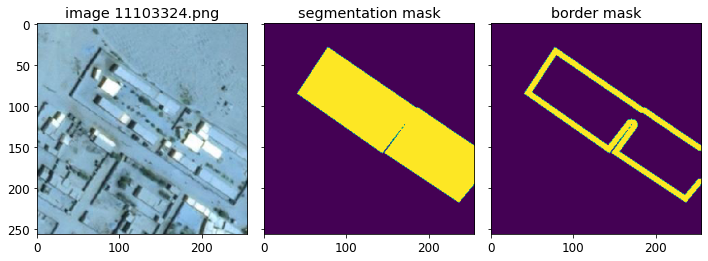

In [161]:
plt.rcParams.update({'font.size': 12})
indx = 18
name, mask, border  = posdata.loc [indx, ['name', 'mask', 'border']]

img = cv.imread(schoolpath + name)

fig, (ax0, ax1, ax2) = plt.subplots(1,3, figsize = (10,5), sharey= True)
ax0.imshow(img)
ax0.set_title(f'image {name}')
ax1.imshow(mask)
ax1.set_title('segmentation mask')
ax2.imshow(border)
ax2.set_title('border mask')
plt.tight_layout()
plt.show()

# 2. Generate The Train/Val/Test Split Dataframes
The ``buildSplits`` class takes in the positive dataframe and creates the train/val/test splits where each split is returned each as a dataframe.

The testset dataframe ``test_df`` can either contain positive data only (i.e, school class tiles) or can also include negative data (non-school tiles).

***Note***: *Training UNETs on negative data (where targets are black masks)is often found to be not feasible.* 

***Training was done on the positive class only.***

In [5]:
from preprocess import buildSplits, augmentation
splitter = buildSplits(posdata, mixdatapath)
train_df, val_df, test_df = splitter.sklearn_splits()
print(train_df.shape, val_df.shape, test_df.shape)
test_df

(3342, 3) (836, 3) (2045, 3)


,name,mask,border
0,51412314.png,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
1,12603318.png,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
2,44403307.png,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
3,42901344.png,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
4,51503347_N.png,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
...,...,...,...
2040,63102303_S.png,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
2041,42502331.png,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
2042,51503361.png,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
2043,51503364.png,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...","[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."


# 3. Create Augmentations and Dataflow Generators
The ``augmentation`` class uses the splits dataframes to return image generators to train/validate/evaluate the model. The generators use the splits dataframe as inputs to the ``flow_from_dataframe`` keras method.

the class controls for missing/corrupted images to ensure that each input image is validated and connected to its correct label mask.

***Note: The ``test_gen`` is using positive data only, a total of 1045 school images.***

In [6]:
from preprocess import augmentation             
aug = augmentation()
aug.batch_size = 12

In [120]:
train_gen = aug.get_splitgen(train_df, schoolpath)
val_gen = aug.get_splitgen(val_df, schoolpath)
test_gen = aug.get_splitgen(test_df, schoolpath, test = True)

Found 3342 validated image filenames.
Found 836 validated image filenames.
Found 1045 validated image filenames.


# 4. Building The Model Architecture
The ``fitEval`` class returns a ``trainer`` object that can be used to train and evaluate and inspect the model performance.

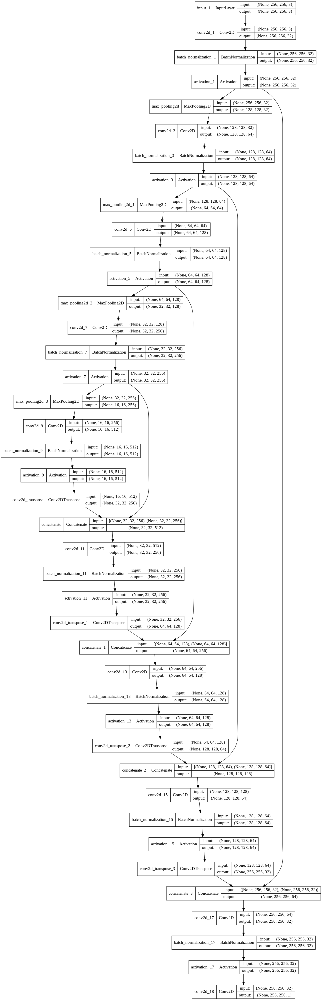

In [ ]:
from models import fitEval
runpath = datapath + 'model_newrun_postive/'
logpath = runpath + 'logs/'
checkpath = runpath + 'checks/'

trainer = fitEval(simple = True, log_path= logpath, checkpnt_path= checkpath)
trainer.plot

In [ ]:
trainer.summary()

Model: "U_SIMPLE"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_5 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_77 (Conv2D)             (None, 256, 256, 32  896         ['input_5[0][0]']                
                                )                                                                 
                                                                                                  
 batch_normalization_73 (BatchN  (None, 256, 256, 32  128        ['conv2d_77[0][0]']              
 ormalization)                  )                                                          

# 5. Model Training

Cleaning the loging path

In [ ]:
# logfiles = glob(logpath + '/*')
# [os.remove(f) if os.path.isfile(f) else shutil.rmtree(f) for f in logfiles]

[None, None, None]

Using the ``trainer.fit`` method to train the model over 600 epochs divided into 3 milestones, of 200 epochs each. The first 200 epochs were trained by a learning rate $1e^{-3}$, the second 200 epochs were trained at $1e^{-4}$, while the last 200 epochs were trained at $1e^{-5}$.

All performance was logged and weights were saved at the end of each epoch.

In [ ]:
length = (3342, 836, 1045 )
trainer_dct = {'epochs': 200,
                'batchsize' : 12}

lr_sch = [0.001, 0.0001, 0.00001]
trainer.checkpnt_path = checkpath

for round, rate in zip(range(1,4), lr_sch) :
  trainer.lr = rate
  trainer.fit(train_gen,
              val_gen, round, length, user_dct = trainer_dct)

Epoch 1/200
83/83 [==============================] - ETA: 0s - loss: 1.2625 - iou: 0.2081 - mAP: 1.0000e-07 - precsn: 1.0000e-07 - recall: 1.0000e-07
Epoch 00001: saving model to /content/tempchecks/1_mchp_0001.hdf5
83/83 [==============================] - 21s 204ms/step - loss: 1.2625 - iou: 0.2081 - mAP: 1.0000e-07 - precsn: 1.0000e-07 - recall: 1.0000e-07 - val_loss: 5.4156 - val_iou: 0.1799 - val_mAP: 1.0000e-07 - val_precsn: 1.0000e-07 - val_recall: 1.0000e-07
Epoch 2/200
83/83 [==============================] - ETA: 0s - loss: 1.0411 - iou: 0.2475 - mAP: 1.0000e-07 - precsn: 1.0000e-07 - recall: 1.0000e-07
Epoch 00002: saving model to /content/tempchecks/1_mchp_0002.hdf5
83/83 [==============================] - 13s 159ms/step - loss: 1.0411 - iou: 0.2475 - mAP: 1.0000e-07 - precsn: 1.0000e-07 - recall: 1.0000e-07 - val_loss: 1.1779 - val_iou: 0.1605 - val_mAP: 1.0000e-07 - val_precsn: 1.0000e-07 - val_recall: 1.0000e-07
Epoch 3/200
83/83 [==============================] - ETA: 0s

The 3 training csv logs from each milestone (i.e, a file per 200 epoch) were concatenated into a single log dataframe. 

In [117]:
runpath = datapath + 'model_newrun_postive/'
logpath = runpath + 'logs/' + '02_simple/'
checkpath = runpath + 'checks/' + '02_simple/'
logfiles =  glob(logpath + '/*.log') 

dfs = (pd.read_csv(file) for file in logfiles)
trainlog = pd.concat(dfs, ignore_index= True)
trainlog = trainlog.drop(['recall', 'val_recall'], axis = 'columns') # recall is meaningless with only positive data.
trainlog['epoch'] = range(1, 601)
trainlog

,epoch,iou,loss,mAP,precsn,val_iou,val_loss,val_mAP,val_precsn
0,1,0.208100,1.262522,9.999994e-08,9.999994e-08,0.179904,5.415648,9.999998e-08,9.999998e-08
1,2,0.247530,1.041110,9.999994e-08,9.999994e-08,0.160490,1.177908,9.999998e-08,9.999998e-08
2,3,0.270670,0.976595,9.999994e-08,9.999994e-08,0.283613,1.155873,9.999998e-08,9.999998e-08
3,4,0.273129,0.956551,9.999994e-08,9.999994e-08,0.231785,1.026115,9.999998e-08,9.999998e-08
4,5,0.295416,0.926122,9.999994e-08,9.999994e-08,0.271712,1.107564,9.999998e-08,9.999998e-08
...,...,...,...,...,...,...,...,...,...
595,596,0.594638,0.436490,2.610442e-01,9.879518e-01,0.415127,0.876102,5.555654e-03,5.000010e-02
596,597,0.590853,0.445956,2.583667e-01,9.518072e-01,0.416035,0.906877,1.111121e-02,1.000001e-01
597,598,0.595582,0.437546,2.650602e-01,1.000000e+00,0.419425,0.898467,1.111121e-02,1.000000e-01
598,599,0.589324,0.449722,2.570281e-01,9.397590e-01,0.430682,0.850758,1.111121e-02,1.000000e-01


## Plotting the training ``IoU``, ``Loss``, ``Precision`` and ``COCO mAP``.

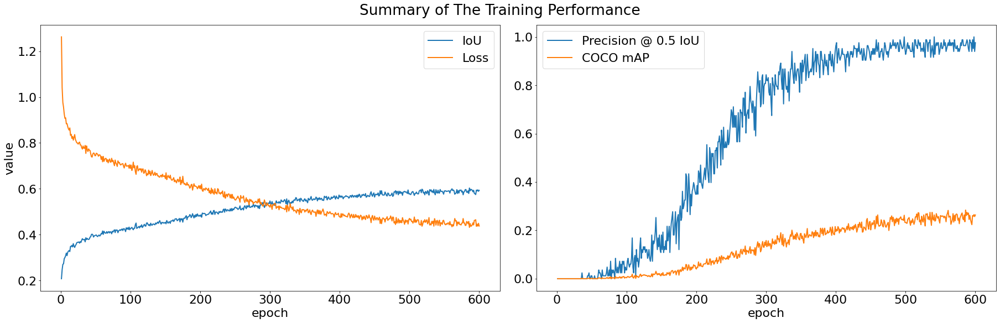

In [141]:
plt.rcParams.update({'font.size': 22})
fig, (ax0, ax1) = plt.subplots(1, 2, figsize= (25, 8), constrained_layout = True)
trainlog.plot(x = 'epoch', y = ['iou', 'loss'], ylabel = 'value', ax = ax0, linewidth=2)
ax0.legend(labels = ['IoU', 'Loss'])
trainlog.plot(x = 'epoch', y = ['precsn', 'mAP'], ax = ax1, linewidth=2)
ax1.legend(labels = ['Precision @ 0.5 IoU', 'COCO mAP'])
plt.suptitle('Summary of The Training Performance')
plt.show()

# 6. Evaluation

In [125]:
trainer.evaluate(test_gen, 1045)

87/87 [==============================] - 283s 3s/step - loss: 0.7026 - iou: 0.6074 - mAP: 0.2963 - precsn: 0.9310 - recall: 0.9310


{'iou': 0.6074355840682983,
 'loss': 0.7026291489601135,
 'mAP': 0.29629629850387573,
 'precsn': 0.931034505367279,
 'recall': 0.931034505367279}

## Creating The Precision Curve @ IoU Thresholds [0.1: 0.95: 0.05]

In [128]:
aug_prc = augmentation()
aug_prc.batch_size = 1
test_gen_prc = aug_prc.get_splitgen(test_df, schoolpath, test = True)

Found 1045 validated image filenames.


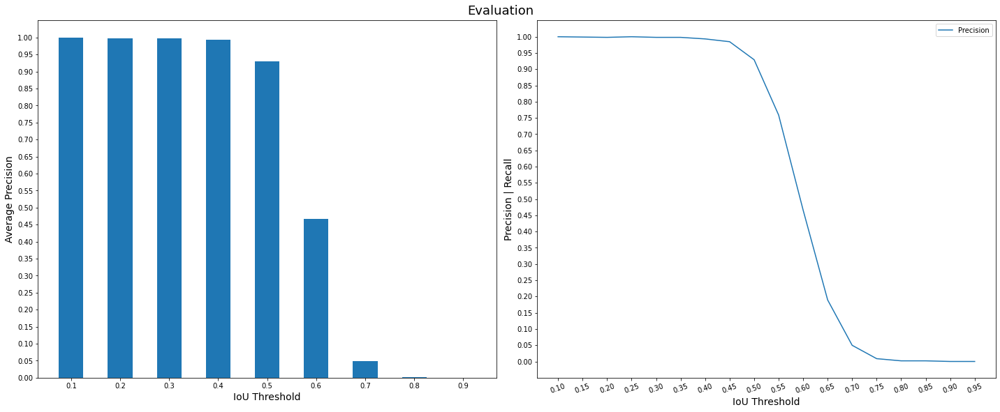

In [ ]:
plt.rcParams.update({'font.size': 12})
pr, rc = trainer.prec_recall(test_gen_prc, 1045)

## Visual Inspection of The Predicted Masks
Inspecting 25 image examples from the testset.

***Note: Orphaned small prediction regions with size < 1000 pixels where removed.***

/content/UNICEF-Giga_Sudan/models.py:279: UserWarning: Only one label was provided to `remove_small_objects`. Did you mean to use a boolean array?
  labels = remove_small_objects(labels, min_size = min_size)


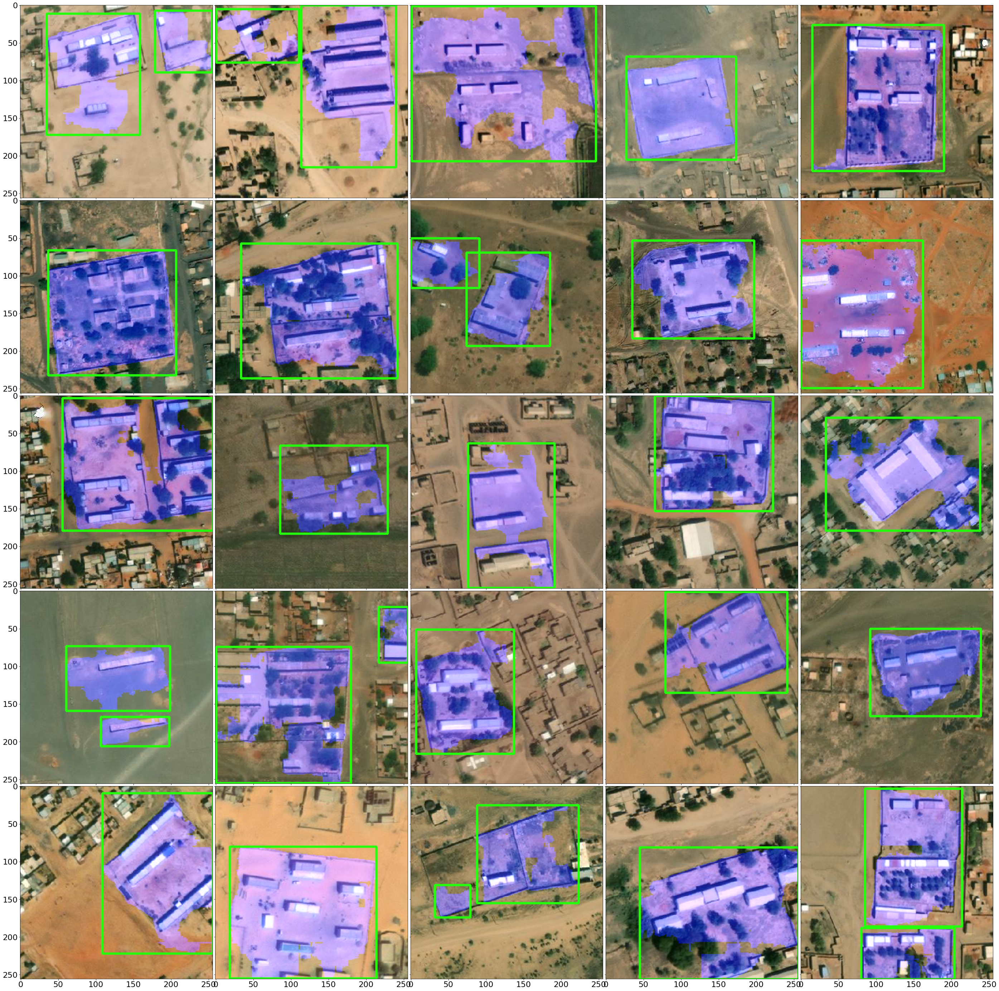

In [127]:
ovs = trainer.inspect_preds(test_gen_prc, 25)

import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid

fig = plt.figure(figsize=(50, 50))
grid = ImageGrid(fig ,111,nrows_ncols= (5,5), axes_pad= 0.1)
for img, grd in zip(ovs, grid):
  grd.imshow(img)

Comparing the same batch with the true label overlays

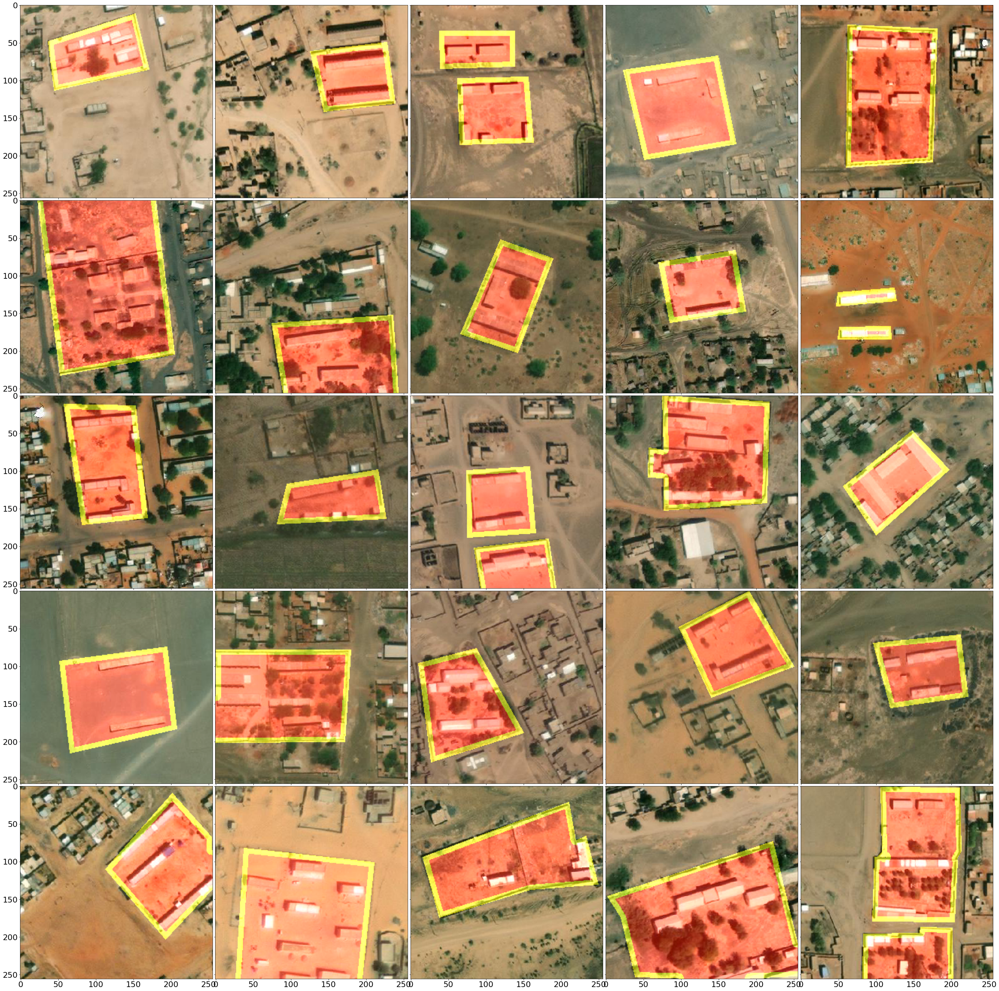

In [129]:
from preprocess import inspect_trues
ovts = inspect_trues(test_gen_prc, 25)

import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid

fig = plt.figure(figsize=(50, 50))
grid = ImageGrid(fig ,111,nrows_ncols= (5,5), axes_pad= 0.1)
for img, grd in zip(ovts, grid):
  grd.imshow(img)